<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Overview" data-toc-modified-id="Overview-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Overview</a></span><ul class="toc-item"><li><span><a href="#Numerical-Features" data-toc-modified-id="Numerical-Features-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Numerical Features</a></span></li><li><span><a href="#Categorical-Features" data-toc-modified-id="Categorical-Features-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Categorical Features</a></span></li><li><span><a href="#Object-Features" data-toc-modified-id="Object-Features-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Object Features</a></span></li><li><span><a href="#Skewness" data-toc-modified-id="Skewness-1.4"><span class="toc-item-num">1.4&nbsp;&nbsp;</span>Skewness</a></span></li><li><span><a href="#Most--and-least-skewed-features-by-G1" data-toc-modified-id="Most--and-least-skewed-features-by-G1-1.5"><span class="toc-item-num">1.5&nbsp;&nbsp;</span>Most- and least skewed features by G1</a></span></li><li><span><a href="#Correlations" data-toc-modified-id="Correlations-1.6"><span class="toc-item-num">1.6&nbsp;&nbsp;</span>Correlations</a></span></li><li><span><a href="#Promotion-history-correlations" data-toc-modified-id="Promotion-history-correlations-1.7"><span class="toc-item-num">1.7&nbsp;&nbsp;</span>Promotion history correlations</a></span></li><li><span><a href="#Giving-history-correlations" data-toc-modified-id="Giving-history-correlations-1.8"><span class="toc-item-num">1.8&nbsp;&nbsp;</span>Giving history correlations</a></span></li></ul></li><li><span><a href="#Targets" data-toc-modified-id="Targets-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Targets</a></span><ul class="toc-item"><li><span><a href="#Binary-target" data-toc-modified-id="Binary-target-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Binary target</a></span></li><li><span><a href="#Discrete-Target" data-toc-modified-id="Discrete-Target-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Discrete Target</a></span></li></ul></li><li><span><a href="#Comparing-months-since-donation-and-donation-amount" data-toc-modified-id="Comparing-months-since-donation-and-donation-amount-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Comparing months since donation and donation amount</a></span></li><li><span><a href="#RFA" data-toc-modified-id="RFA-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>RFA</a></span><ul class="toc-item"><li><span><a href="#All-time-RFA-status" data-toc-modified-id="All-time-RFA-status-4.1"><span class="toc-item-num">4.1&nbsp;&nbsp;</span>All-time RFA status</a></span></li></ul></li><li><span><a href="#Socio-economic-environment-and-urbanicity" data-toc-modified-id="Socio-economic-environment-and-urbanicity-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Socio-economic environment and urbanicity</a></span></li><li><span><a href="#Puttting-donors-on-a-map" data-toc-modified-id="Puttting-donors-on-a-map-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Puttting donors on a map</a></span></li><li><span><a href="#Income,-Wealth-and-donations" data-toc-modified-id="Income,-Wealth-and-donations-7"><span class="toc-item-num">7&nbsp;&nbsp;</span>Income, Wealth and donations</a></span></li></ul></div>

# Exploratory Data Analysis
This notebook contains all code for the prelimiatory analysis of the KDD Cup 98 datasets

In [1]:
%load_ext autoreload

In [2]:
# Set up logging and graphics defaults
%run ./common_init.ipynb

/data/anaconda/envs/py36/lib/python3.6/site-packages/sklearn/externals/six.py:31: DeprecationWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", DeprecationWarning)
/data/anaconda/envs/py36/lib/python3.6/site-packages/sklearn/externals/joblib/__init__.py:15: DeprecationWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=DeprecationWarning)


<Figure size 432x288 with 0 Axes>

Setup logging to file: out.log
Figure output directory saved in figure_output at /home/datarian/OneDrive/unine/Master_Thesis/ma-thesis-report/figures
 cwd: /data/home/datarian/git/master-thesis-msc-statistics/code


In [3]:
%autoreload 2

import kdd98.data_handler as dh
import kdd98.utils_transformer as ut
from kdd98.transformers import *

# Where to save the figures
IMAGES_PATH = pathlib.Path(figure_output / 'eda')

pathlib.Path(IMAGES_PATH).mkdir(parents=True, exist_ok=True)

sns.set_context("poster", rc={"lines.linewidth": 2})
sns.set_palette(Config.get("qual_palette"))

plt.rcParams['figure.figsize'] = (1.618 * 8, 8)


def save_fig(fig_id,
             tight_layout=True,
             fig_extension=["pdf", "png"],
             resolution=300):
    if tight_layout:
        plt.tight_layout()
    [plt.savefig(pathlib.Path(IMAGES_PATH, fig_id + "." + f),
                 format=f, dpi=resolution, transparent=True, bbox_inches='tight')
     for f in fig_extension]

Using TensorFlow backend.


In [5]:
data_provider = dh.KDD98DataProvider("cup98LRN.txt")

In [6]:
raw = data_provider.raw_data

In [7]:
cleaned = data_provider.cleaned_data

The following helper function filters out feature names that were dropped during preprocessing. This prevents errors when retrieving data.

In [8]:
def filter_features(features, dataframe):
    return [f for f in features if f in dataframe.columns.values.tolist()]

## Overview

A first, general look at the data structure after import. EDA is performed on the learning data set.

In [9]:
raw["data"].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 95412 entries, 95515 to 185114
Columns: 478 entries, ODATEDW to GEOCODE2
dtypes: category(24), float64(48), int64(297), object(109)
memory usage: 333.4+ MB


* There are 479 features (of which one is the index)
* A total of 95412 examples
* 24 categorical features, 53 datetime features, 48 numerical features with missing values, 297 integer features without missing values and 56 string features

In [10]:
raw["data"].head()

,ODATEDW,OSOURCE,TCODE,STATE,ZIP,MAILCODE,PVASTATE,DOB,NOEXCH,RECINHSE,...,AVGGIFT,HPHONE_D,RFA_2R,RFA_2F,RFA_2A,MDMAUD_R,MDMAUD_F,MDMAUD_A,CLUSTER2,GEOCODE2
CONTROLN,,,,,,,,,,,,,,,,,,,,,
95515,8901,GRI,0,IL,61081,,NaN,3712,0,,...,7.741935,0,L,4,E,X,X,X,39.0,C
148535,9401,BOA,1,CA,91326,,NaN,5202,0,,...,15.666667,0,L,2,G,X,X,X,1.0,A
15078,9001,AMH,1,NC,27017,,NaN,0,0,,...,7.481481,1,L,4,E,X,X,X,60.0,C
172556,8701,BRY,0,CA,95953,,NaN,2801,0,,...,6.812500,1,L,4,E,X,X,X,41.0,C
7112,8601,NaN,0,FL,33176,,NaN,2001,0,X,...,6.864865,1,L,2,F,X,X,X,26.0,A


### Numerical Features

Numerical features are of either integer or float data types.

In [11]:
numerical = raw["data"].select_dtypes(include=np.number).columns
print("There are {:1} numerical features".format(len(numerical)))

There are 345 numerical features


### Categorical Features

Some categories were automatically picked up on import of the csv data. Per the data set dictionary, there should be more than these.

In [12]:
categories = raw["data"].select_dtypes(include='category').columns
print(categories)

Index(['STATE', 'PVASTATE', 'DOMAIN', 'CLUSTER', 'CHILD03', 'CHILD07',
       'CHILD12', 'CHILD18', 'INCOME', 'GENDER', 'WEALTH1', 'DATASRCE',
       'SOLP3', 'SOLIH', 'WEALTH2', 'GEOCODE', 'LIFESRC', 'RFA_2R', 'RFA_2F',
       'RFA_2A', 'MDMAUD_R', 'MDMAUD_F', 'MDMAUD_A', 'GEOCODE2'],
      dtype='object')


Some observations are:

* The state with the largest number of members is California (STATE)
* The largest class regarding socio-economic status is rural in economic status category 2 of 3 (DOMAIN), so we have medium-income donors living in rural communities as the predominant group.
* Regarding the income class from 1 - 7, most donors are in class 5 (INCOME)
* Most donors are females (GENDER)

In [13]:
raw["data"].loc[:, categories].describe().transpose()

,count,unique,top,freq
STATE,95412,57,CA,17343
PVASTATE,1458,2,P,1453
DOMAIN,93096,16,R2,13623
CLUSTER,93096,53,40,3979
CHILD03,1146,3,M,869
CHILD07,1566,3,M,1061
CHILD12,1811,3,M,1149
CHILD18,2847,3,M,1442
INCOME,74126,7,5,15451
GENDER,92455,6,F,51277


### Object Features

In [14]:
objects = raw["data"].select_dtypes(include='object').columns.values.tolist()
print(objects)

['ODATEDW', 'OSOURCE', 'TCODE', 'ZIP', 'MAILCODE', 'DOB', 'NOEXCH', 'RECINHSE', 'RECP3', 'RECPGVG', 'RECSWEEP', 'MDMAUD', 'AGEFLAG', 'HOMEOWNR', 'MAJOR', 'COLLECT1', 'VETERANS', 'BIBLE', 'CATLG', 'HOMEE', 'PETS', 'CDPLAY', 'STEREO', 'PCOWNERS', 'PHOTO', 'CRAFTS', 'FISHER', 'GARDENIN', 'BOATS', 'WALKER', 'KIDSTUFF', 'CARDS', 'PLATES', 'PEPSTRFL', 'ADATE_2', 'ADATE_3', 'ADATE_4', 'ADATE_5', 'ADATE_6', 'ADATE_7', 'ADATE_8', 'ADATE_9', 'ADATE_10', 'ADATE_11', 'ADATE_12', 'ADATE_13', 'ADATE_14', 'ADATE_15', 'ADATE_16', 'ADATE_17', 'ADATE_18', 'ADATE_19', 'ADATE_20', 'ADATE_21', 'ADATE_22', 'ADATE_23', 'ADATE_24', 'RFA_2', 'RFA_3', 'RFA_4', 'RFA_5', 'RFA_6', 'RFA_7', 'RFA_8', 'RFA_9', 'RFA_10', 'RFA_11', 'RFA_12', 'RFA_13', 'RFA_14', 'RFA_15', 'RFA_16', 'RFA_17', 'RFA_18', 'RFA_19', 'RFA_20', 'RFA_21', 'RFA_22', 'RFA_23', 'RFA_24', 'MAXADATE', 'RDATE_3', 'RDATE_4', 'RDATE_5', 'RDATE_6', 'RDATE_7', 'RDATE_8', 'RDATE_9', 'RDATE_10', 'RDATE_11', 'RDATE_12', 'RDATE_13', 'RDATE_14', 'RDATE_15', '

The date features are not yet encoded into actual dates. Therefore, they still show up as Object dtype. Also, many binary features are not yet encoded correctly.

In [15]:
raw["data"].loc[:, objects].describe().transpose()

,count,unique,top,freq
ODATEDW,95412,54,9501,15358
OSOURCE,94484,895,MBC,4539
TCODE,95412,55,0,40917
ZIP,95412,19938,85351,61
MAILCODE,95412,2,,94013
DOB,95412,947,0,23661
NOEXCH,95405,3,0,95085
RECINHSE,95412,2,,88709
RECP3,95412,2,,93395
RECPGVG,95412,2,,95298


### Skewness

There are too many features for an individual graphical analysis. Instead, skewness is calculated for each feature and then displayed in an overview plot.

`pandas`'s function `skew()` is used to calculate skew for the whole data set. Pandas calculates the adjusted Fisher-Pearson standardized moment coefficient G1. Only available for numeric features

Adjusted Fisher-Pearson standardized moment coefficient:

$G_1 = \frac{\sqrt{n(n-1)}}{n-2}\frac{1}{n}\frac{\sum_{i=1}^n (x_i-\bar{x})^3}{s^3}$

In [16]:
cleaned_skew = cleaned["data"].select_dtypes(include="number").skew()

In [17]:
cleaned_skew = pd.DataFrame(cleaned_skew, columns=["skew_stat"])
cleaned_skew.index.name = "feature"

In [18]:
def calc_conf_bound(feature):
    # Under H_0, mean = 0 and var(feature) = var(N(0,6))
    n = feature.count()
    return 1.96 * np.sqrt(6 * n * (n - 1) / ((n - 2) * (n + 1) *
                                             (n + 3))) / np.sqrt(n)


def within_bound(feature):
    return "Yes" if abs(feature.skew_stat) < feature.conf_bound else "No"

In [19]:
conf_bound = pd.DataFrame(cleaned["data"].apply(calc_conf_bound,
                                                axis=0,
                                                result_type="expand"),
                          columns=["conf_bound"])
conf_bound.index.name = "feature"

In [20]:
skew = cleaned_skew.merge(conf_bound, on=cleaned_skew.index.name)

In [21]:
skew['inside_ci'] = skew.apply(within_bound, axis=1, result_type="expand")

In [22]:
skew.inside_ci.value_counts()

No    389
Name: inside_ci, dtype: int64

The dots indicate skewness for each numeric featue in the data. The blue lines are the confidence bound for G1 at $\alpha$ = 5 % for $H_0$: Data is distributed normally.

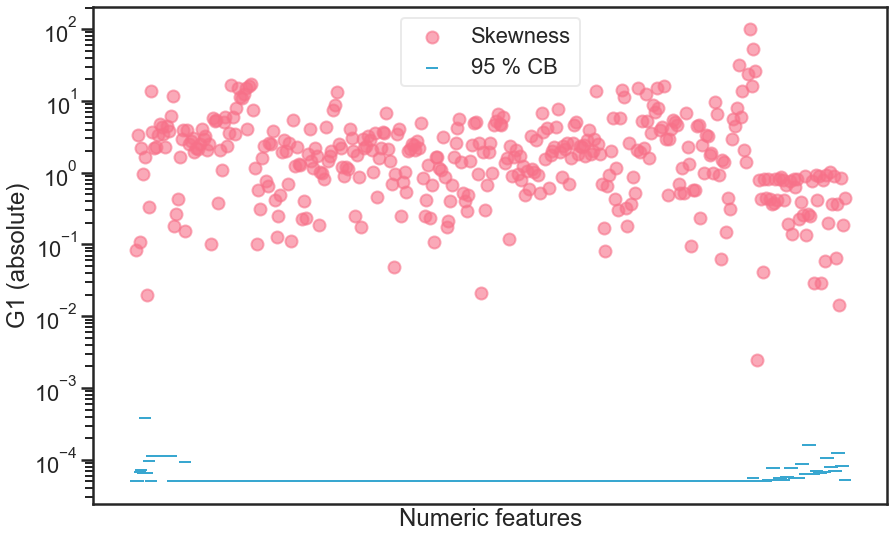

In [23]:
fig, ax = plt.subplots(1, 1)
plt.scatter(x=skew.index,
            y=abs(skew.skew_stat),
            alpha=0.6,
            c=Config.get("qual_palette_binary")[0],
            label="Skewness")
plt.scatter(x=skew.index,
            y=skew.conf_bound,
            marker="_",
            c=Config.get("qual_palette_binary")[1],
            label="95 % CB")
plt.tick_params(
    axis='x',  # changes apply to the x-axis
    which='both',  # both major and minor ticks are affected
    bottom=False,  # ticks along the bottom edge are off
    top=False,  # ticks along the top edge are off
    labelbottom=False)  # labels along the bottom edge are off
plt.legend()
plt.xlabel("Numeric features")
plt.ylabel("G1 (absolute)")
plt.yscale("log")
save_fig("skewness-numeric-features")

### Most- and least skewed features by G1

In [24]:
most_skewed = skew.sort_values(by="skew_stat",
                               ascending=True).dropna().tail(n=6).sort_values(
                                   by="skew_stat", ascending=False)
most_skewed

,skew_stat,conf_bound,inside_ci
feature,,,
MAXRAMNT,99.783762,0.000050,No
TIMELAG,52.624164,0.000056,No
RAMNT_18,31.202689,0.000050,No
AVGGIFT,26.049429,0.000050,No
MINRAMNT,23.849919,0.000050,No
ETH15,17.002337,0.000050,No


In [25]:
cleaned["data"].loc[:, most_skewed.index].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 95412 entries, 95515 to 185114
Data columns (total 6 columns):
MAXRAMNT    95412 non-null float64
TIMELAG     85439 non-null float64
RAMNT_18    95412 non-null float64
AVGGIFT     95412 non-null float64
MINRAMNT    95412 non-null float64
ETH15       95412 non-null int64
dtypes: float64(5), int64(1)
memory usage: 5.1 MB


In [26]:
cleaned["data"].loc[:, most_skewed.index].describe().transpose()

,count,mean,std,min,25%,50%,75%,max
feature,,,,,,,,
MAXRAMNT,95412.0,19.999790,25.067746,5.000000,14.000000,17.000000,23.000000,5000.0
TIMELAG,85439.0,8.093739,8.213242,0.000000,4.000000,6.000000,11.000000,1088.0
RAMNT_18,95412.0,2.546205,7.320857,0.000000,0.000000,0.000000,0.000000,1000.0
AVGGIFT,95412.0,13.347786,10.769997,1.285714,8.384615,11.636364,15.477955,1000.0
MINRAMNT,95412.0,7.933656,8.784231,0.000000,3.000000,5.000000,10.000000,1000.0
ETH15,95412.0,0.327433,3.208650,0.000000,0.000000,0.000000,0.000000,81.0


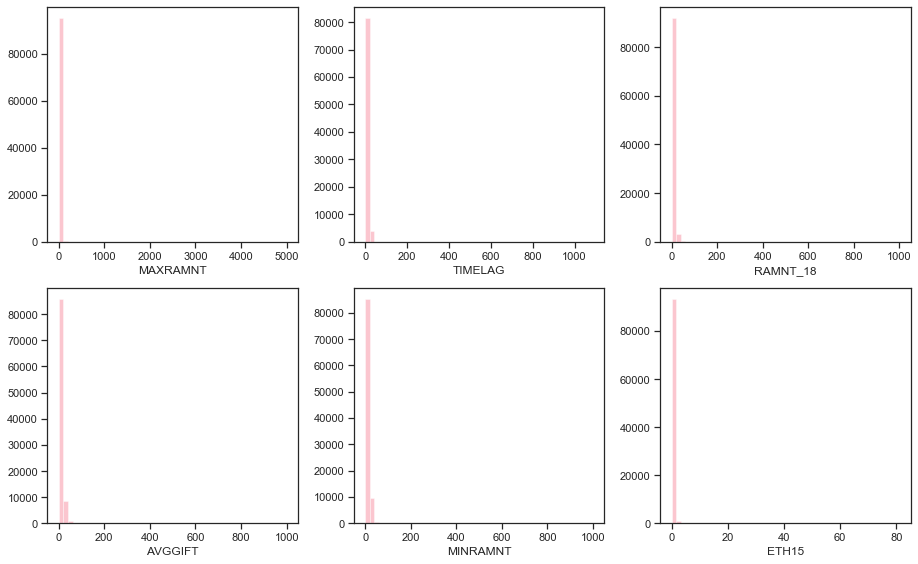

In [27]:
sns.set_context("notebook")
fig = plt.figure()

for i in range(0, len(most_skewed.index)):
    ax = fig.add_subplot(2,3,i+1)
    sns.distplot(cleaned["data"].loc[:, most_skewed.index[i]].dropna(), kde=False, label=most_skewed.index[i], ax=ax)

save_fig("most-skewed")

In [28]:
least_skewed = skew.loc[abs(skew.skew_stat) <= 0.1,
                        ["skew_stat", "conf_bound"]].applymap(abs).sort_values(
                            by="skew_stat").head(6)

In [29]:
cleaned["data"].loc[:, least_skewed.index].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 95412 entries, 95515 to 185114
Data columns (total 6 columns):
HPHONE_D    95412 non-null Int64
RFA_23A     39116 non-null Int64
INCOME      74126 non-null Int64
HHAS3       95412 non-null int64
RFA_18A     74149 non-null Int64
RFA_16A     74995 non-null Int64
dtypes: Int64(5), int64(1)
memory usage: 5.6 MB


In [30]:
cleaned["data"].loc[:, least_skewed.index].describe().transpose()

,count,mean,std,min,25%,50%,75%,max
feature,,,,,,,,
HPHONE_D,95412.0,0.500618,0.500002,0.0,0.0,1.0,1.0,1.0
RFA_23A,39116.0,5.349627,0.971570,2.0,5.0,5.0,6.0,7.0
INCOME,74126.0,3.886248,1.854960,1.0,2.0,4.0,5.0,7.0
HHAS3,95412.0,42.962971,17.054347,0.0,31.0,43.0,55.0,99.0
RFA_18A,74149.0,5.136657,1.041385,1.0,4.0,5.0,6.0,7.0
RFA_16A,74995.0,5.262057,1.023387,1.0,5.0,5.0,6.0,7.0


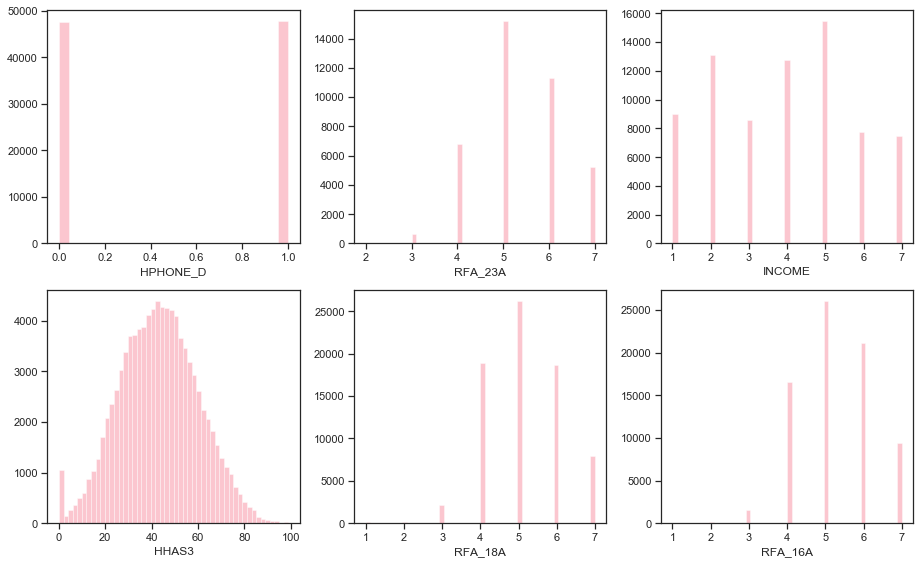

In [31]:
fig = plt.figure()

for i in range(0, len(most_skewed.index)):
    ax = fig.add_subplot(2,3,i+1)
    sns.distplot(cleaned["data"].loc[:, least_skewed.index[i]].astype("float64").dropna(), kde=False, label=most_skewed.index[i], ax=ax)

save_fig("least-skewed")

In [32]:
sns.set_context("poster", rc={"lines.linewidth": 2})

### Correlations

Correlations can be studied for numerical data only. Shown below are correlations between all numerical features in the data set. It is not possible to identify individual features, but correlations within and between the main blocks of data left-to-right, top-to-bottom in the heatmap: member database, US census, promotion history, giving history can be identified.

In [33]:
corr_all = cleaned["data"].corr()

In [34]:
mask_all = np.zeros_like(corr_all, dtype=np.bool)
mask_all[np.triu_indices_from(mask_all)] = True

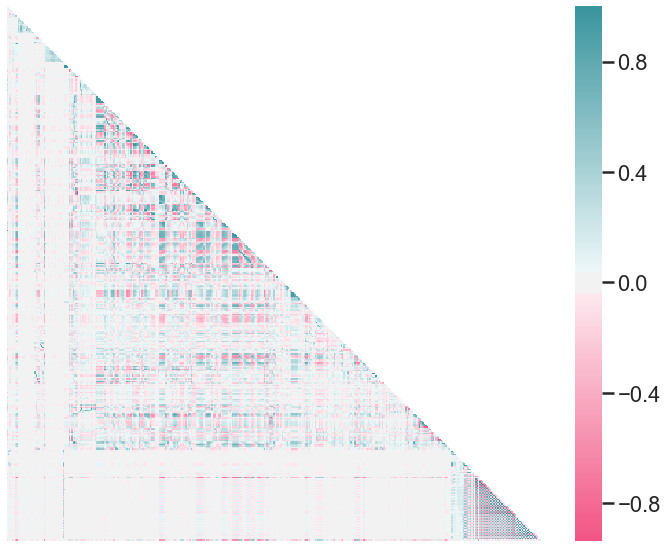

In [35]:
plt.rcParams["figure.figsize"] = (10, 10)

fig, ax = plt.subplots(1, 1)

sns.heatmap(corr_all,
            cmap=Config.get("diverging_color_map"),
            mask=mask_all,
            vmax=1.0,
            center=0.0,
            square=True,
            linewidths=0,
            xticklabels=False,
            yticklabels=False,
            cbar_kws={"shrink": 0.8})
ax.set_ylabel('')    
ax.set_xlabel('')
save_fig(fig_id="correlations-all")
plt.rcParams["figure.figsize"] = (1.618 * 10, 10)

### Promotion history correlations

Not much interesting information can be extracted here. The ADATE_* features (sending date of a promotion) are almost constant as promotions are usually all mailed within one or two months

In [36]:
promotion_history_features = cleaned["data"].loc[:,
                                                 filter_features(
                                                     dh.PROMO_HISTORY_SUMMARY +
                                                     dh.PROMO_HISTORY_DATES,
                                                     cleaned["data"])]
promotion_history_features = promotion_history_features.astype(np.number)

In [37]:
prom_hist_corr = promotion_history_features.corr()
prom_hist_corr

feature,CARDPROM,NUMPROM,CARDPM12,NUMPRM12,ADATE_5,ADATE_7,ADATE_8,ADATE_9,ADATE_10,ADATE_11,...,ADATE_15,ADATE_16,ADATE_17,ADATE_18,ADATE_19,ADATE_20,ADATE_21,ADATE_22,ADATE_23,ADATE_24
feature,,,,,,,,,,,,,,,,,,,,,
CARDPROM,1.000000,0.949052,0.406926,0.321836,NaN,-0.013764,0.358765,0.198321,-0.084806,0.146568,...,NaN,-0.026065,0.428525,0.305036,0.264630,0.014999,0.429802,0.110245,-0.001449,0.009731
NUMPROM,0.949052,1.000000,0.403414,0.512446,NaN,-0.022556,0.347834,0.192579,-0.076566,0.140253,...,NaN,-0.026904,0.411390,0.300551,0.234586,0.050928,0.415738,0.133289,-0.028790,0.002543
CARDPM12,0.406926,0.403414,1.000000,0.613361,NaN,-0.082271,0.299725,0.224904,-0.012315,0.037286,...,NaN,-0.001186,0.074765,0.051478,0.023078,0.009775,0.069782,0.037959,-0.013368,-0.096810
NUMPRM12,0.321836,0.512446,0.613361,1.000000,NaN,-0.078079,0.160462,0.110100,-0.007783,0.026757,...,NaN,-0.011519,0.055116,0.057671,0.030208,0.060178,0.071005,0.066989,-0.032733,-0.074125
ADATE_5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ADATE_7,-0.013764,-0.022556,-0.082271,-0.078079,NaN,1.000000,0.093767,0.041047,0.009157,0.010290,...,NaN,0.022379,0.014677,-0.011286,0.002810,0.000548,-0.007304,-0.009762,0.007674,0.167891
ADATE_8,0.358765,0.347834,0.299725,0.160462,NaN,0.093767,1.000000,0.515381,-0.000427,0.091292,...,NaN,0.026649,0.121965,0.155382,-0.010448,-0.051773,0.024802,0.010752,0.072798,0.203074
ADATE_9,0.198321,0.192579,0.224904,0.110100,NaN,0.041047,0.515381,1.000000,-0.005222,-0.196029,...,NaN,0.019140,0.038333,0.128580,-0.003478,0.001972,0.024358,0.013935,0.000067,0.060420
ADATE_10,-0.084806,-0.076566,-0.012315,-0.007783,NaN,0.009157,-0.000427,-0.005222,1.000000,-0.118978,...,NaN,0.007969,-0.027698,-0.106638,-0.001689,-0.004841,-0.047219,0.000881,0.005463,0.007609


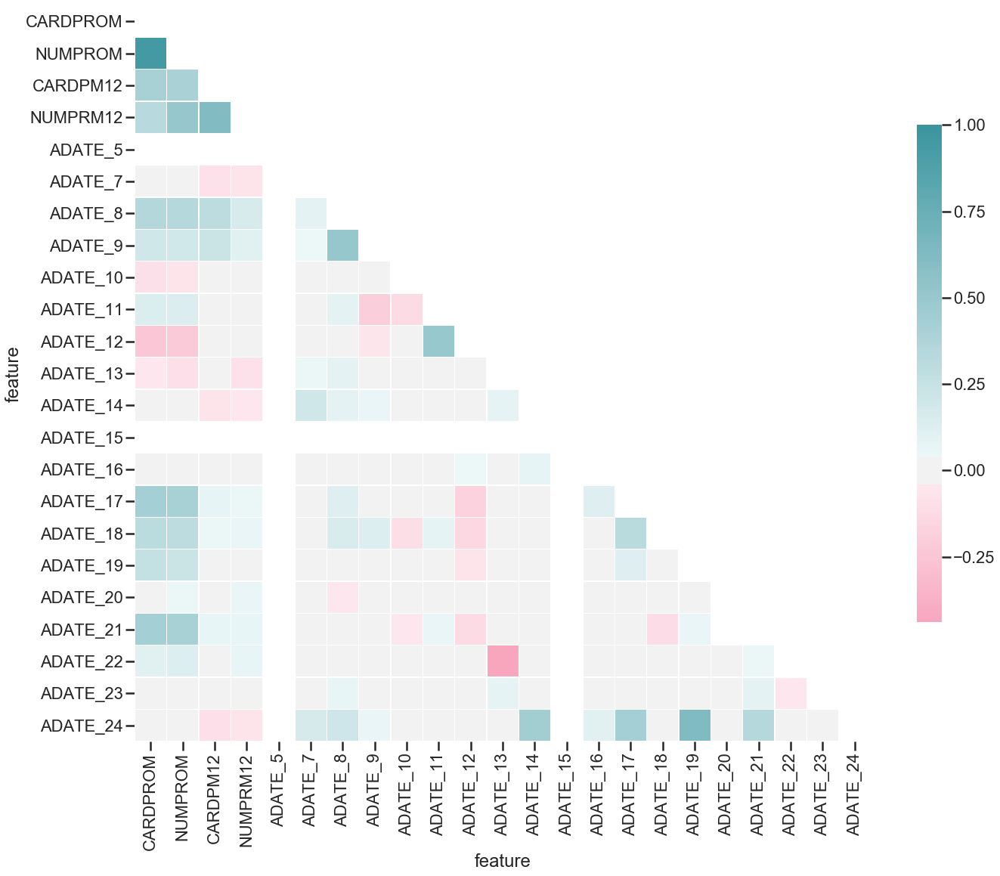

In [38]:
mask_promo = np.zeros_like(prom_hist_corr, dtype=np.bool)
mask_promo[np.triu_indices_from(mask_promo)] = True

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 20))

sns.heatmap(prom_hist_corr,
            mask=mask_promo,
            cmap=Config.get("diverging_color_map"),
            vmax=1.0,
            center=0,
            square=True,
            linewidths=.3,
            cbar_kws={"shrink": .5},
            xticklabels=True,
            yticklabels=True)
save_fig(fig_id="correlations-promotion-giving-history")

### Giving history correlations

We can observe:

* Donation amounts between donations for individual promotions RAMNT_* are positively correlated. Donor behaviour is thus quite constant across promotions.
* Especially RAMNT_5 shows very strong (near-perfect) correlation with most other RAMNT_* features. RAMNT_5 could maybe serve as a global RAMNT feature, dropping the others.
* There is a weak negative correlation between the number of all-time donations (NGIFTALL) and the donation amounts, indicating that frequent donors tend to give small amounts.

In [39]:
giving_hist_f = dh.GIVING_HISTORY + dh.GIVING_HISTORY_SUMMARY + [
    'LASTDATE_DELTA_MONTHS', 'MINRDATE_DELTA_MONTHS', 'MAXRDATE_DELTA_MONTHS',
    'MAXADATE_DELTA_MONTHS'
]
giving_history_features = raw[
    "data"].loc[:, filter_features(giving_hist_f, raw["data"])].astype(
        np.number)
giving_corr = giving_history_features.corr()
mask_giving = np.zeros_like(giving_corr, dtype=np.bool)
mask_giving[np.triu_indices_from(mask_giving)] = True

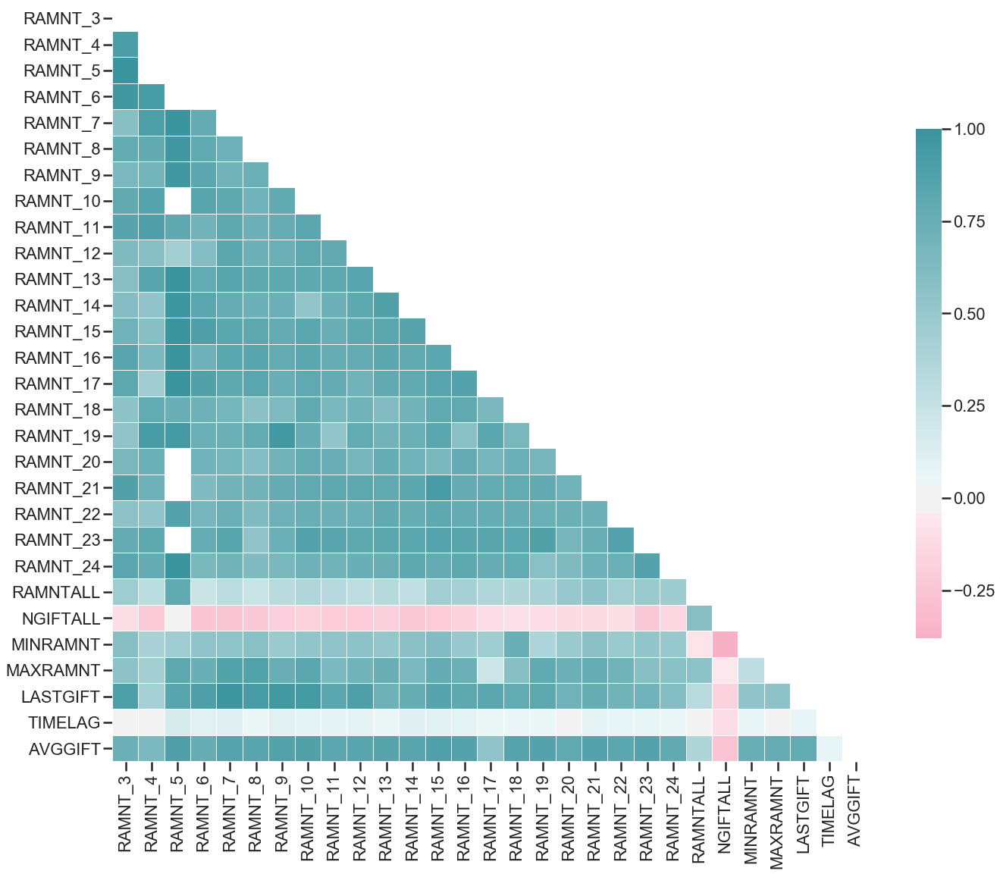

In [40]:

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 20))

sns.heatmap(giving_corr,
            mask=mask_giving,
            cmap=Config.get("diverging_color_map"),
            vmax=1.0,
            center=0,
            square=True,
            linewidths=.1,
            cbar_kws={"shrink": .5},
            xticklabels=True,
            yticklabels=True)
save_fig(fig_id="correlations-giving-history")

## Targets

### Binary target
TARGET_B indicates wheter an example donated in the current campaign. It is obviously very imbalanced, with only 5.1 % of members donating.

In [41]:
plt.rcParams["figure.figsize"] = (1.618 * 8, 8)

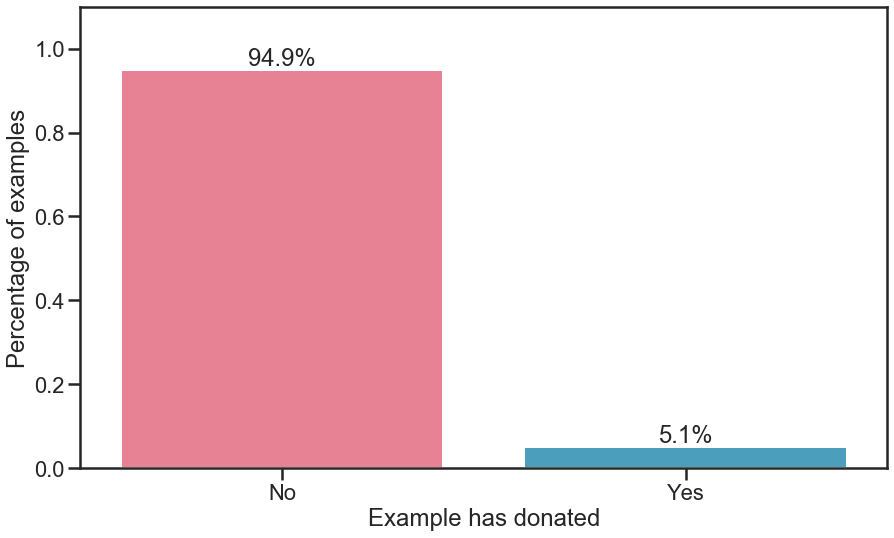

In [42]:
def show_values_on_bars(axs):
    def _show_on_single_plot(ax):
        for p in ax.patches:
            _x = p.get_x() + p.get_width() / 2
            _y = p.get_y() + p.get_height() + 0.01
            value = '{:.1%}'.format(p.get_height())
            ax.text(_x, _y, value, ha="center")

    if isinstance(axs, np.ndarray):
        for idx, ax in np.ndenumerate(axs):
            _show_on_single_plot(ax)
    else:
        _show_on_single_plot(axs)

ax.set_ylabel('')    
ax.set_xlabel('')

fig = sns.barplot(
    x=[0, 1],
    y=cleaned["targets"].groupby('TARGET_B')['TARGET_B'].count() /
    len(cleaned["targets"].index),
    palette=Config.get("qual_palette_binary"))
fig.set_xticklabels(["No", "Yes"])
plt.xlabel("Example has donated")
plt.ylabel("Percentage of examples")
plt.ylim([0, 1.1])
show_values_on_bars(fig)

save_fig(fig_id="ratio-binary")

### Discrete Target
TARGET_D represents the dollar amount donated in the current campaign. Including all the non-donors:

In [43]:
cleaned["targets"].TARGET_D.describe()

count    95412.000000
mean         0.793073
std          4.429725
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max        200.000000
Name: TARGET_D, dtype: float64

Looking at the distribution of only the donors:

In [44]:
cleaned["targets"].TARGET_D.loc[cleaned["targets"].TARGET_D > 0.0].describe()

count    4843.000000
mean       15.624344
std        12.445137
min         1.000000
25%        10.000000
50%        13.000000
75%        20.000000
max       200.000000
Name: TARGET_D, dtype: float64

In [45]:
cleaned["targets"].TARGET_D.loc[cleaned["targets"].TARGET_D > 0.0].mode()

0    10.0
dtype: float64

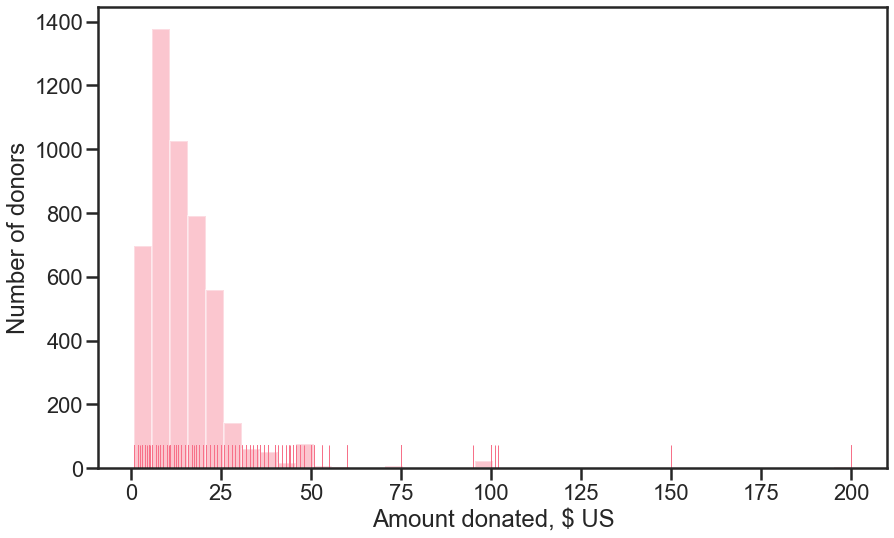

In [46]:
fig = sns.distplot(
    cleaned["targets"].loc[cleaned["targets"].TARGET_D > 0.0, 'TARGET_D'],
    bins=40,
    kde=False,
    rug=True)
plt.ylabel("Number of donors")
plt.xlabel("Amount donated, \$ US")
save_fig('target-distribution')

In [47]:
cleaned["targets"].loc[cleaned["targets"].TARGET_D > 0.0, 'TARGET_D'].median()

13.0

**Summary of target observations**

* The binary target is imbalanced, with roughly 95% / 5%
* Most donations are below 20 dollars. The median is 13 \$
* Spikes are visible for 5, 10, 15, 20, 25, 50, 100 and 200 $
* The continuous target's distribution is right-skewed

## Comparing months since donation and donation amount 

Checking the claim from the documentation that donations are positively correlated with the time since the last donation. We plot the duration since the last gift against the donation amount for the current campaign. The marker size indicates the total number of times an example has donated so far.

In [48]:
numeric = data_provider.numeric_data

In [49]:
numeric_combined = numeric["data"].join(numeric["targets"],
                                        on=numeric["data"].index)

It is evident that from a lag of &geq; 15 months, donations increase indeed, and over the whole spectrum of amounts. We see a marked difference in 100- and 50 $ donations.

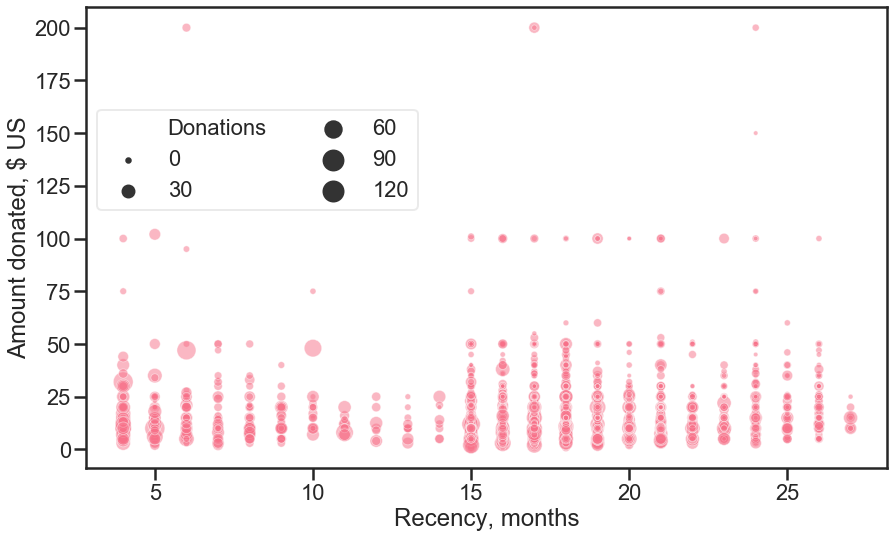

In [50]:
fig, ax = plt.subplots(1,1)
g = sns.scatterplot(
    x='LASTDATE_DELTA_MONTHS',
    y='TARGET_D',
    size='Donations',
    alpha=0.5,
    data=numeric_combined.loc[numeric_combined.TARGET_D > 0.0, :].rename(
        columns={"NGIFTALL": "Donations"}),
    sizes=(20, 400))

g.legend(loc='upper left', bbox_to_anchor=(0.0, 0.8),
          ncol=2)

plt.xlabel("Recency, months")
plt.ylabel("Amount donated, \$ US")
save_fig(fig_id="donations-vs-time-since-last-size-nbr-donations")

## RFA 

In [51]:
cleaned_combined = cleaned["data"].join(cleaned["targets"],
                                        on=cleaned["data"].index)

In [52]:
rfa_data = numeric["data"].loc[:, ["LASTDATE_DELTA_MONTHS", "RAMNTALL", "NGIFTALL", "ODATEDW_DELTA_YEARS"]].join(numeric["targets"].TARGET_B,
                                        on=numeric["data"].index)
rfa_data["DONATIONS_PER_YEAR"] = rfa_data.NGIFTALL / rfa_data.ODATEDW_DELTA_YEARS
rfa_data["AMOUNT_PER_YEAR"] = rfa_data.RAMNTALL / rfa_data.ODATEDW_DELTA_YEARS
rfa_data.columns = ["Recency", "Total Donations", "Cumulative number of donations", "Time since first donation", "Donated", "Frequency", "Yearly Amount"]

### All-time RFA status 

In [53]:
rfa_data.Donated = np.where(rfa_data.Donated == 1, "Yes", "No")

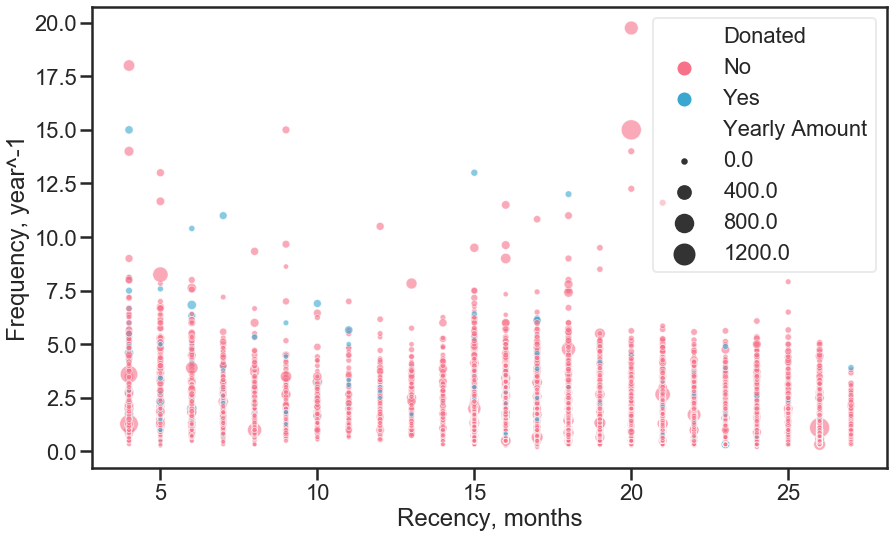

In [54]:
fig, ax = plt.subplots(1,1)
ax = sns.scatterplot(x="Recency", size="Yearly Amount",
                     y="Frequency", hue="Donated", alpha=0.6,
                     data=rfa_data,
                     sizes=(20, 400), palette = Config.get("qual_palette_binary"))
plt.xlabel("Recency, months")
plt.ylabel("Frequency, year^-1")
save_fig("rfa-alltime-current-donors")

Amount donated vs. Frequency in the last active 12-month period of the lapsed donors. Frequent donors give less.

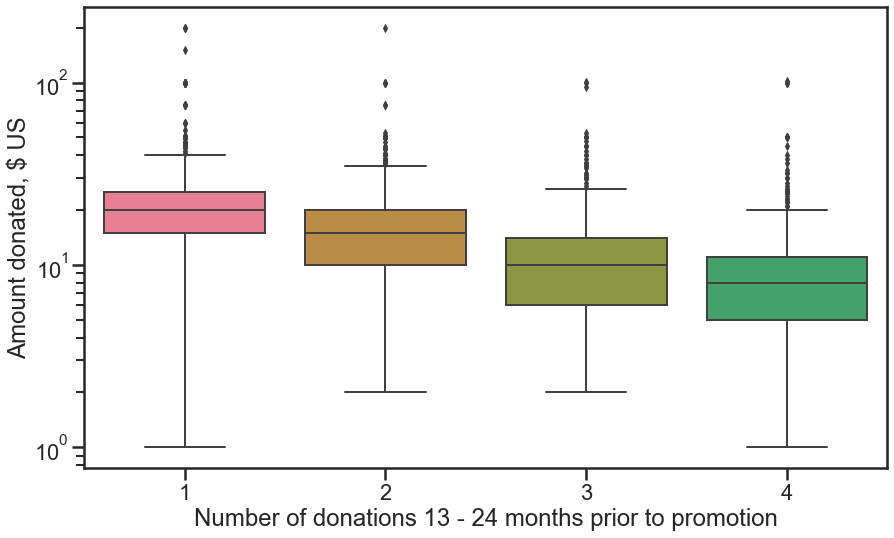

In [55]:
sns.set_palette(Config.get("qual_palette"))
ax = sns.boxplot(x="RFA_2F", y="TARGET_D", data=cleaned_combined.loc[cleaned_combined.TARGET_D > 0.0,:])
ax.set_yscale('log')
plt.xlabel("Number of donations 13 - 24 months prior to promotion")
plt.ylabel("Amount donated, $ US")
save_fig("frequency-past-donatios-vs-donations")

Checking if there is a linear relationship between current and last donation. No clear linear trend is apparent.

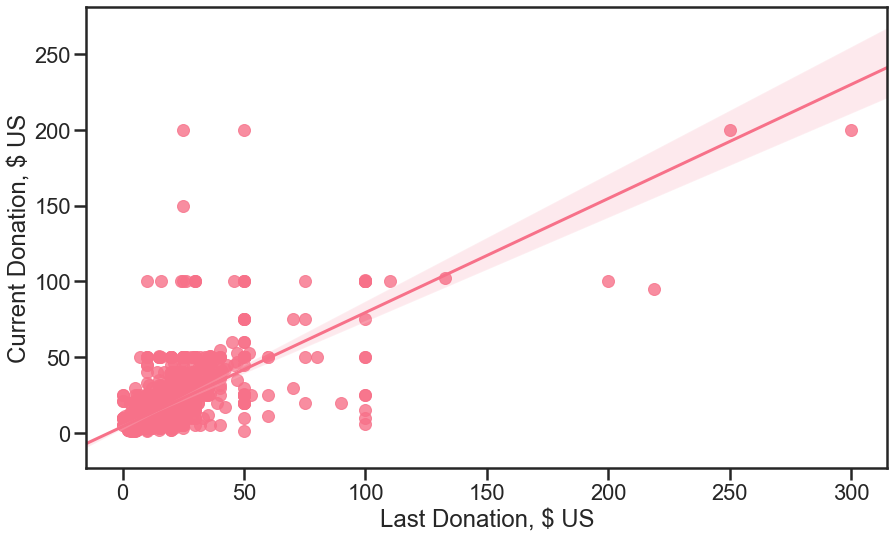

In [56]:
ax = sns.regplot(x="LASTGIFT", y="TARGET_D", data=cleaned_combined.loc[(cleaned_combined.TARGET_D > 0.0)&(cleaned_combined.AVGGIFT <= 200.0),:])
plt.xlabel("Last Donation, $ US")
plt.ylabel("Current Donation, $ US")
save_fig("target-d-vs-lastgift")

## Socio-economic environment and urbanicity

Donations by living environment (C=City, R=Rural, S=Suburban, T=Town,U=Urban)

In [57]:
socioec_data = cleaned["data"].loc[:, [
    "RAMNTALL", "WEALTH1", "WEALTH2", "CLUSTER", "DOMAINUrbanicity",
    "DOMAINSocioEconomic"
]]
socioec_data = socioec_data.join(cleaned["targets"], on=socioec_data.index).join(numeric["data"].loc[:,["ODATEDW_DELTA_YEARS"]], on=socioec_data.index)
maj_data = raw["data"].loc[:, ["MAJOR"]].rename(
    columns={"MAJOR": "Major donor"})
maj_data["Major donor"] = maj_data.loc[:, "Major donor"].map({
    " ": "No",
    "X": "Yes",
    "": "No"
})

socioec_data = socioec_data.merge(maj_data, on=socioec_data.index.name)
socioec_data.DOMAINUrbanicity.cat.reorder_categories(['C', 'U', 'S', 'T', 'R'],
                                                     inplace=True)
socioec_data.DOMAINSocioEconomic = socioec_data.loc[:, "DOMAINSocioEconomic"].map({
    1: "High",
    2: "Medium",
    3: "Low"
})

In [58]:
socioec_data

,RAMNTALL,WEALTH1,WEALTH2,CLUSTER,DOMAINUrbanicity,DOMAINSocioEconomic,TARGET_B,TARGET_D,ODATEDW_DELTA_YEARS,Major donor
CONTROLN,,,,,,,,,,
95515,240.0,NaN,6,36,T,Medium,0,0.0,9,No
148535,47.0,10,10,14,S,High,0,0.0,4,No
15078,202.0,2,2,43,R,Medium,0,0.0,8,No
172556,109.0,5,1,44,R,Medium,0,0.0,11,No
7112,254.0,3,NaN,16,S,Medium,0,0.0,12,No
47784,51.0,NaN,NaN,40,T,Medium,0,0.0,4,No
62117,107.0,7,4,40,T,Medium,0,0.0,11,No
109359,31.0,10,NaN,39,T,Medium,0,0.0,4,No
75768,199.0,3,3,45,R,Medium,0,0.0,10,No


Median donation amount for the current promotion is always higher for the High status group, however where present, the lowest status is almost on par. Poor people seem to donate large amounts on average. A hypothesis is that they know hardship first-hand and want to help out others who they think are even worse off.

The highest donations come from City and Rural environments.

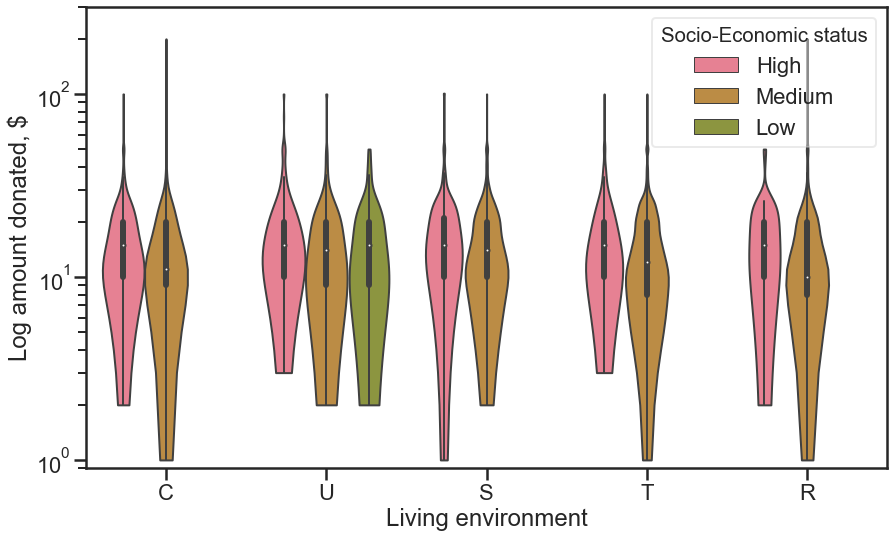

In [59]:
ax = sns.violinplot(y="TARGET_D",
                    x="DOMAINUrbanicity",
                    hue='Socio-Economic status',
                    cut=0,
                    data=socioec_data.loc[cleaned["targets"].TARGET_D > 0.0,:].rename(
        columns={"DOMAINSocioEconomic": "Socio-Economic status"}),
                    palette=Config.get("qual_palette"),
                    legend_out=True)
ax.set_yscale('log')

#new_labels = ['No', 'Yes']
#for t, l in zip(g._legend.texts, new_labels): t.set_text(l)

plt.xlabel("Living environment")
plt.ylabel("Log amount donated, \$")
plt.ylim(0.9, 300)
save_fig(fig_id="donations-vs-living-environment-hue-socioecon")

Lifetime donations by environment. The y- axis is in log scale. Medium socio-economic status examples tend to have slightly higher lifetime donations compared to both high and low classes.

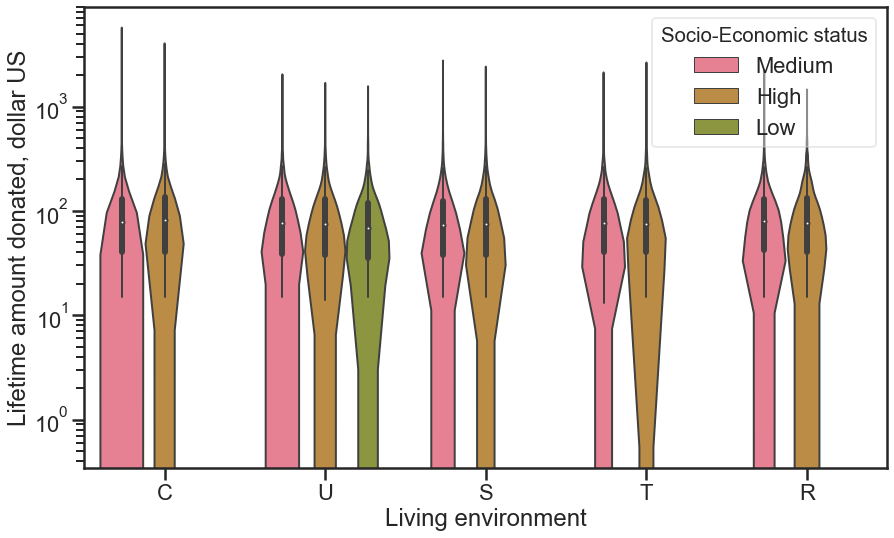

In [60]:
fig = sns.violinplot(y="RAMNTALL",
                  x="DOMAINUrbanicity",
                  hue='Socio-Economic status',
                  data=socioec_data.rename(
        columns={"DOMAINSocioEconomic": "Socio-Economic status"}),
                  palette=Config.get("qual_palette"))
fig.set_yscale('log')
plt.xlabel("Living environment")
plt.ylabel("Lifetime amount donated, dollar US")
save_fig(fig_id="all-time-donations-vs-living-environment")

In [61]:
socioec_data["AVG_YEARLY_DONATION"] = socioec_data.RAMNTALL / socioec_data.ODATEDW_DELTA_YEARS
urb_aggr = {
    "RAMNTALL": {
        "total": 'sum',
        "count": 'count', 
        "average_per_capita": lambda x: sum(x) / len(x)
    },
    "AVG_YEARLY_DONATION" : {
        "median": 'median'  
    }
}

urb_aggregated = socioec_data.groupby("DOMAINUrbanicity").agg(urb_aggr)
urb_aggregated.head()

/data/anaconda/envs/py36/lib/python3.6/site-packages/pandas/core/groupby/generic.py:1315: FutureWarning: using a dict with renaming is deprecated and will be removed in a future version
  return super(DataFrameGroupBy, self).aggregate(arg, *args, **kwargs)


RAMNTALL                           AVG_YEARLY_DONATION
                       total  count average_per_capita              median
DOMAINUrbanicity                                                          
C                 2093369.00  19689         106.321753           12.500000
U                 1235531.07  12166         101.556064           12.500000
S                 2217430.10  21924         101.141676           12.500000
T                 1983062.63  19527         101.554905           12.333333
R                 2042308.85  19790         103.199032           12.000000

Cumulative lifetime donations per living environment. The cumulative donations mainly follow the number of members in each living environment. Average per capita lifetime donations are however highest for the City group, followed by Rural.

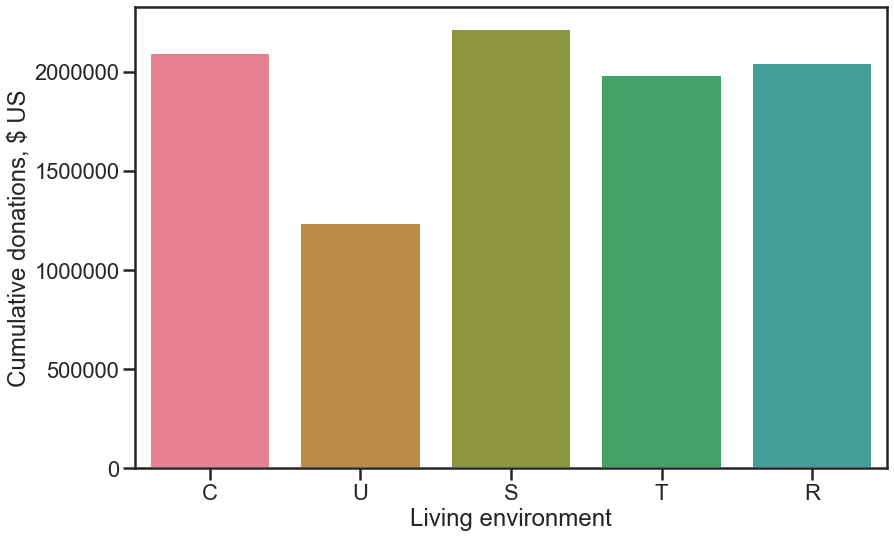

In [62]:
sns.barplot(x=urb_aggregated.index, y=urb_aggregated.RAMNTALL.total)

plt.xlabel("Living environment")
plt.ylabel("Cumulative donations, \$ US")
save_fig("cum-donations-by-living-environment")

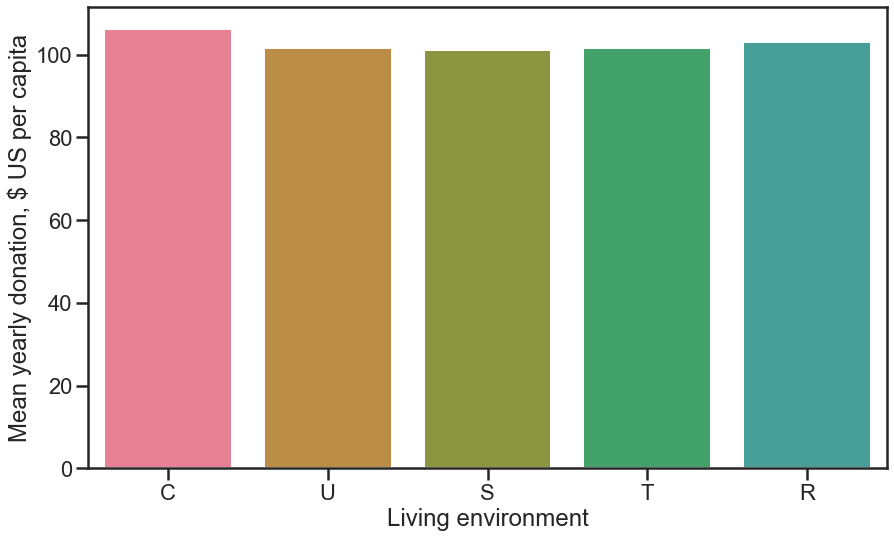

In [63]:
sns.barplot(x=urb_aggregated.index,
            y=urb_aggregated.RAMNTALL.average_per_capita)

plt.xlabel("Living environment")
plt.ylabel("Mean yearly donation, \$ US per capita")
save_fig("avg-donations-per-capita-by-living-environment")

Major donors are those identified by the organization as the most valuable. The Major status clearly separates the lifetime amount donated.

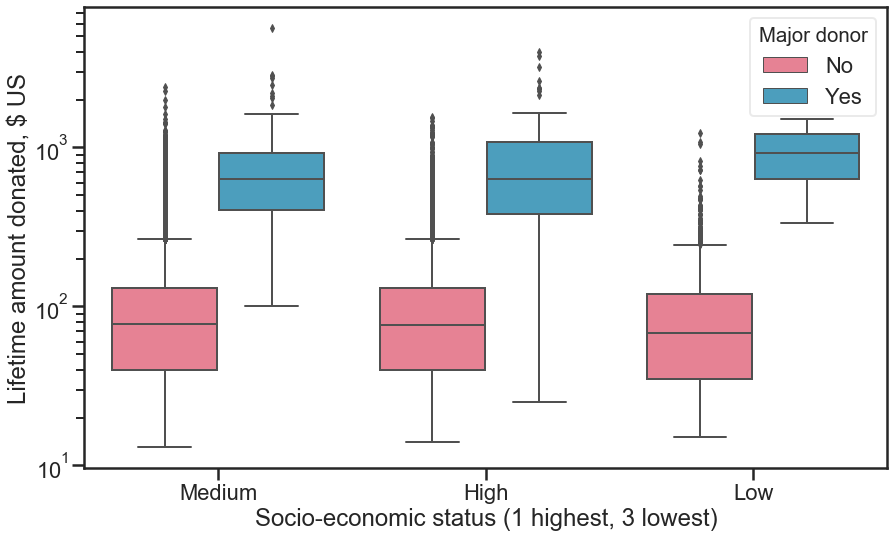

In [64]:
fig = sns.boxplot(y="RAMNTALL",
                  x="DOMAINSocioEconomic",
                  hue='Major donor',
                  data=socioec_data,
                  palette=Config.get("qual_palette_binary"))
fig.set_yscale('log')
plt.xlabel("Socio-economic status (1 highest, 3 lowest)")
plt.ylabel("Lifetime amount donated, \$ US")
save_fig(fig_id="all-time-donations-vs-socio-economic")

## Puttting donors on a map

In [65]:
num_donors_by_zip = cleaned_combined[['ZIP', 'TARGET_B']].groupby(
    'ZIP', as_index=False).agg('sum')  # number of people who donated
num_members_by_zip = cleaned_combined[['ZIP', 'TARGET_B']].groupby(
    'ZIP', as_index=False).agg(
        'count')  # number of people who are registered at that ZIP
cum_donation_by_zip = cleaned_combined[['ZIP', 'TARGET_D'
                                        ]].groupby('ZIP',
                                                   as_index=False).agg('sum')
zip_states = cleaned_combined[['ZIP', 'STATE']].drop_duplicates()

In [66]:
data_by_zip = cum_donation_by_zip.merge(num_members_by_zip,
                                        on='ZIP').merge(zip_states, on='ZIP')
data_by_zip.columns = ["ZIP", "CumDonation", "MemberCount", "State"]

In [67]:
def rel_donation(row):
    if row.CumDonation != 0.0:
        return row.CumDonation / (1.0 if row.MemberCount == 0.0 else
                                  row.MemberCount)
    else:
        return 0.0


data_by_zip['RelDonation'] = data_by_zip.apply(rel_donation, axis=1)

In [68]:
from geopy.geocoders import Here
from geopy.extra.rate_limiter import RateLimiter
from geopy.exc import GeocoderTimedOut


def do_geo_query(q):
    geolocator = Here(app_id="ZJBxigwxa1QPHlWrtWH6",
                      app_code="OJBun02aepkFbuHmYn1bOg")
    geocode = RateLimiter(geolocator.geocode,
                          min_delay_seconds=0.01,
                          max_retries=4)
    try:
        return geolocator.geocode(query=q, exactly_one=True)
    except GeocoderTimedOut:
        return do_geo_query(q)


def get_location(example):
    if example.ZIP:
        zip = str(example.ZIP).rjust(5, '0')
        q = {'postalcode': zip, 'state': example.STATE}
        location = do_geo_query(q)
        if location:
            loc = {
                'ZIP_latitude': location.latitude,
                'ZIP_longitude': location.longitude
            }
        else:
            logger.info(
                "No location found for zip {} in state {}. Setting to 0, 0".
                format(zip, example.STATE))
            loc = {'ZIP_latitude': 0, 'ZIP_longitude': 0}
    else:
        print("ZIP is NaN, setting location to NaN as well.")
        loc = {'ZIP_latitude': np.nan, 'ZIP_longitude': np.nan}
    return loc


def extract_coords(example):
    try:
        return locations[example.ZIP]
    except KeyError:
        if example.STATE in ["AA", "AE",
                             "AP"]:  # military zip, no coords available
            locations[example.ZIP] = {
                'ZIP_latitude': 38.8719,
                'ZIP_longitude': 77.0563
            }
        else:
            try:
                loc = get_location(example)
                locations[example.ZIP] = loc
            except Exception as e:
                logger.info(
                    "Failed to retrieve missing zip. Reason: {}".format(e))
        return locations[example.ZIP]

In [69]:
import pickle
with open(pathlib.Path(Config.get("data_dir"), "zip_db.pkl"), "rb") as zdb:
    locations = pickle.load(zdb)

In [70]:
data_by_zip[['latitude',
             'longitude']] = data_by_zip.apply(extract_coords,
                                               axis=1,
                                               result_type="expand")

AA, AE and AP stand for armed services. ZIP codes don't work here, they point anywhere. Also, we only include locations where someone has actually donated by filtering on CumDonation.

In [71]:
data_by_zip1 = data_by_zip.loc[data_by_zip.State != ['AA', 'AE', 'AP'], :]
data_by_zip2 = data_by_zip1.loc[data_by_zip1.CumDonation > 0.0, :]

/data/anaconda/envs/py36/lib/python3.6/site-packages/pandas/core/arrays/categorical.py:128: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return getattr(np.array(self), op)(np.array(other))


In [72]:
data_by_zip_only_donations = data_by_zip.loc[data_by_zip.CumDonation > 0.0, :]

In [73]:
data_by_zip_only_donations.head()

,ZIP,CumDonation,MemberCount,State,RelDonation,latitude,longitude
53,5261,4.0,1,VT,4.0,42.770286,-73.179047
62,6320,10.0,1,CT,10.0,41.348837,-72.102029
66,6468,11.0,1,CT,11.0,41.339236,-73.222828
70,6514,40.0,1,CT,40.0,41.376803,-72.942752
82,7205,6.0,1,NJ,6.0,40.695889,-74.228800


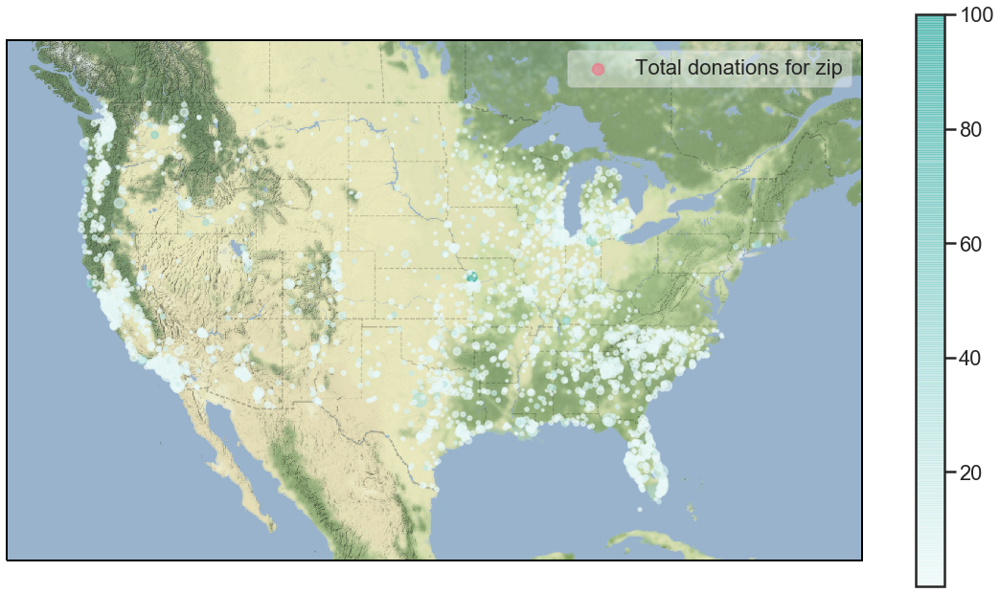

In [74]:
import cartopy.crs as ccrs
import cartopy.io.img_tiles as cimgt
import cartopy.feature as cfeature



fig = plt.figure(figsize=(20, 11))
#terrain = cimgt.OSM()
terrain = cimgt.Stamen('terrain-background')

ax = fig.add_subplot(1, 1, 1, projection=terrain.crs)

ax.set_extent([-130, -65, 21, 52], crs=ccrs.PlateCarree())
ax.add_image(terrain, 5)

lon = data_by_zip_only_donations.longitude
lat = data_by_zip_only_donations.latitude
mc = data_by_zip_only_donations.MemberCount
cd = data_by_zip_only_donations.CumDonation
rd = data_by_zip_only_donations.RelDonation
data_by_zip_only_donations.plot(kind="scatter",
                                x="longitude",
                                y="latitude",
                                ax=ax,
                                s=cd,
                                c=rd,
                                label="Total donations for zip",
                                legend=True,
                                alpha=0.6,
                                cmap=Config.get("seq_color_map"),
                                subplots=True,
                                colorbar=True,
                                transform=ccrs.PlateCarree())

save_fig(fig_id="donations-geographical", tight_layout=False)

* Most donations come from the urban areas, especially San Francisco, Los Angeles, Miami, Chicago and Detroit. To a lesser extent, cities like Houston, Dallas, Minneapolis, Atlanta, Tampa, Seattle and Phoenix can be made out.
* Interestingly, the East Coast has not donated, despite featuring some large metropolitan areas like New York, Boston, or Washington

## Income, Wealth and donations

We see that the distribution changes gradually from lowest to highest income class. Amount donated shifts from lower to higher amounts. Top donations however come from the lowest and 3rd highest classes.

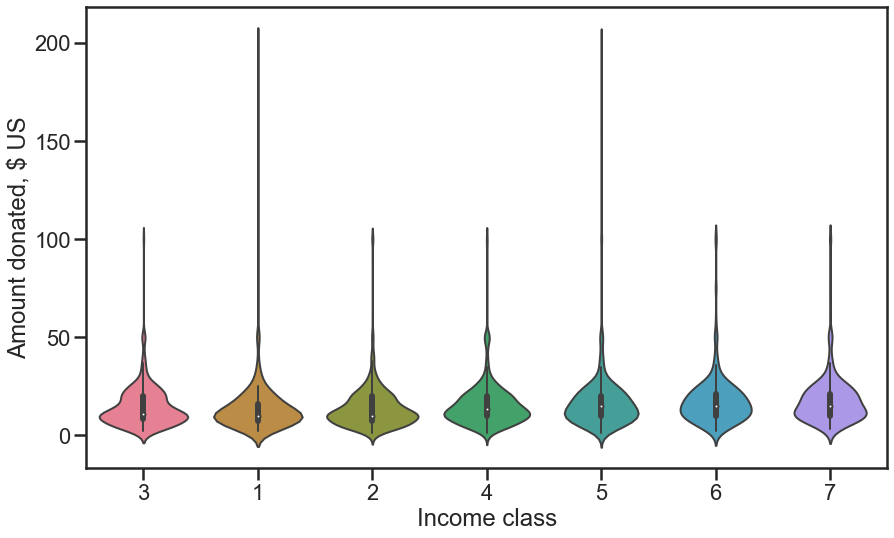

In [75]:
inc_targ = sns.violinplot(
    x="INCOME",
    y="TARGET_D",
    data=cleaned_combined.
    loc[cleaned_combined.TARGET_D > 0.0, ["INCOME", "TARGET_D"]])
plt.xlabel("Income class")
plt.ylabel("Amount donated, \$ US")
save_fig("donations-by-income-class")

The same can be found regarding the wealth classes.

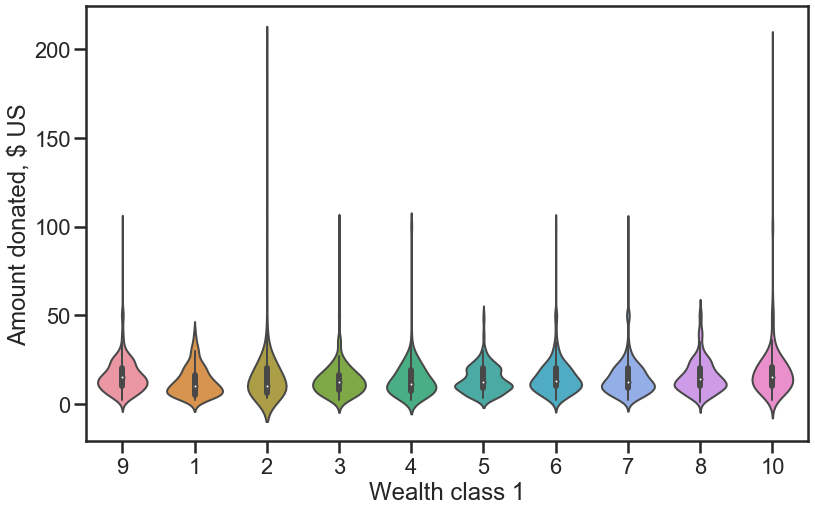

In [76]:
weal1_targ = sns.violinplot(
    x="WEALTH1",
    y="TARGET_D",
    data=cleaned_combined.
    loc[cleaned_combined.TARGET_D > 0.0, ["WEALTH1", "TARGET_D"]])

plt.xlabel("Wealth class 1")
plt.ylabel("Amount donated, \$ US")
plt.show()